## Bird Animations
Some different 3d / 2d embeded in 3d animations

In [1]:
from flock import *


C:\Users\bennm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\mpl_toolkits\mplot3d\proj3d.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return np.array([xs, ys, zs, np.ones_like(xs)])


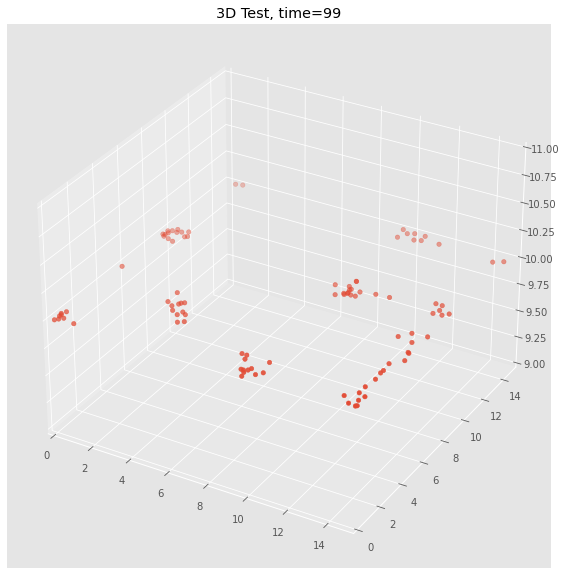

In [17]:

f= Flock(100,0.5,15)
p = f.positions

def update_graph(num):
    f.update_posdirs(1,0.1)
    p = f.positions
    graph._offsets3d = (p[:,0], p[:,1], 10)
    title.set_text('3D Vicsek Birds, time={}'.format(num))


fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111, projection='3d')
ax.set(xlim=(0,15),ylim=(0,15),zlim=(9,11))
title = ax.set_title('3D Vicsek Birds')

p =f.positions
graph = ax.scatter(p[:,0],p[:,1],10)
ani = matplotlib.animation.FuncAnimation(fig, update_graph, 100, 
                               interval=40, blit=False)

HTML(ani.to_jshtml())

In [ ]:
fi = r"C://Users//bennm//Documents//UNI//Year 2//Mathematical Programming//Project//vicsek-model-group3//vicsek_flocking_3d.mp4"
writervideo = animation.FFMpegWriter(fps=60) 
ani.save(fi, writer=writervideo)

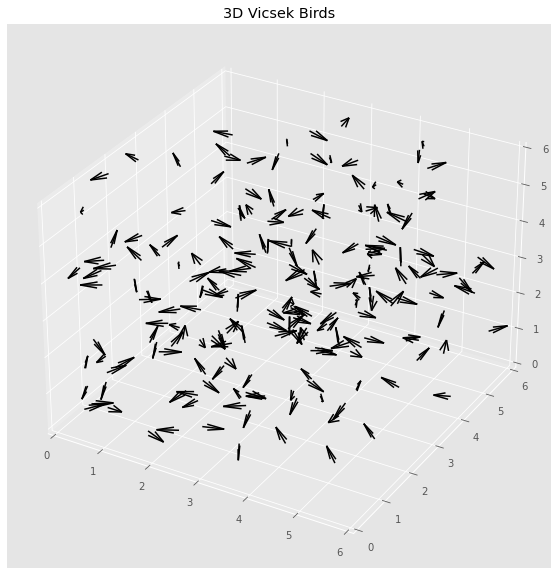

In [1]:
from flock import *
num_r =6
f_3d =Flock_3d(200,0.5,num_r)

fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111, projection='3d')
k=2
ax.set(xlim=(0,num_r),ylim=(0,num_r),zlim=(0,num_r))
title = ax.set_title('3D Vicsek Birds')
p=f_3d.positions
d = f_3d.directions
graph =ax.quiver(p[:,0],p[:,1],p[:,2],d[:,0],d[:,1],d[:,2],length=num_r/15,arrow_length_ratio = 0.8,color="k")
##sadly can't update 3d quiver directions as they are a different kind of object

In [7]:
##animate 3d flock from random
num_R =6
f_3d= Flock_3d(100,0.5,num_R)
p = f_3d.positions

def update_graph(num):
    f_3d.update_posdirs(1,1.5)
    p = f_3d.positions
    graph._offsets3d = (p[:,0], p[:,1], p[:,2])
    title.set_text('3D Vicsek Birds, time={}'.format(num))
    #ambient camera rotation
    ax.azim = -60 +num

fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111, projection='3d')
ax.set(xlim=(0,num_R),ylim=(0,num_R),zlim=(0,num_R))
title = ax.set_title('3D Vicsek Birds')

p =f_3d.positions
graph = ax.scatter(p[:,0],p[:,1],p[:,2])
ani = matplotlib.animation.FuncAnimation(fig, update_graph, 400, 
                               interval=40, blit=False)

HTML(ani.to_jshtml())

ValueError: matmul: Input operand 1 has a mismatch in its core dimension 0, with gufunc signature (n?,k),(k,m?)->(n?,m?) (size 1 is different from 3)

Animation size has reached 21032668 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


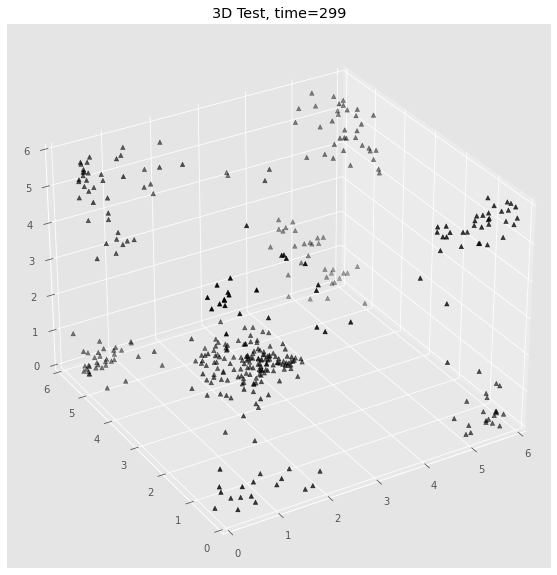

In [19]:
##animate 3d flock from sphere
from flock import *
num_R =6
B =400
B_sqrt = 20
f_3d= Flock_3d(B,0.3,num_R)
thetas = np.linspace(0,2*np.pi,B_sqrt)
phis = np.linspace(0,np.pi,B_sqrt)
P,T = np.meshgrid(phis,thetas)
f_3d.positions = num_R*np.array([np.cos(T)*np.sin(P),np.sin(T)*np.sin(P),np.cos(P)]).transpose().reshape(B,3)/2
f_3d.positions += np.full(f_3d.positions.shape,[num_R/2,num_R/2,num_R/2])
# f_3d.directions = np.array([np.cos(T)*np.sin(P),np.sin(T)*np.sin(P),np.cos(P)]).transpose().reshape(B,3)

def update_graph(num):
    f_3d.update_posdirs(1,0.1)
    p = f_3d.positions
    d =f_3d.directions
    graph._offsets3d = (p[:,0], p[:,1], p[:,2])
    #no set_UVC method for 3d quiver :(
    title.set_text('3D Vicsek Birds, time={}'.format(num))
    #ambient camera rotation
    ax.azim = -60 +num

fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111, projection='3d')
ax.set(xlim=(0,num_R),ylim=(0,num_R),zlim=(0,num_R))
title = ax.set_title('3D Vicsek Birds')

p =f_3d.positions
d = f_3d.directions
graph = ax.scatter(p[:,0],p[:,1],p[:,2],color="k",marker="^")
anim2 = matplotlib.animation.FuncAnimation(fig, update_graph, 300, 
                               interval=40, blit=False)

HTML(anim2.to_jshtml())

## Noise Generation in 3d
Investigating ways of generating random points on a sphere with different distributions (uniform and normal), that aren't biased to the poles.

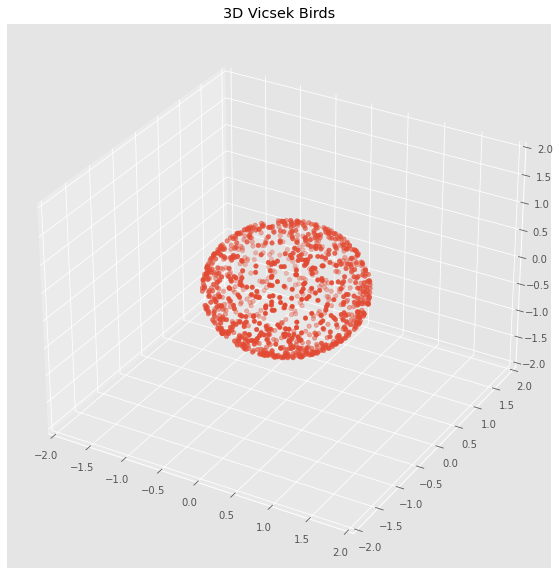

In [9]:
from flock import *
f_3d =Flock_3d(1000,0.5,15)

fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111, projection='3d')
k=2
ax.set(xlim=(-2,2),ylim=(-2,2),zlim=(-2,2))
title = ax.set_title('3D Vicsek Birds')
d = f_3d.directions
graph =ax.scatter(d[:,0],d[:,1],d[:,2])

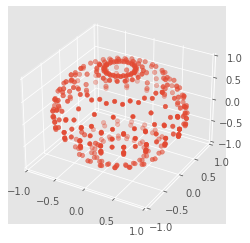

In [4]:
# fig = plt.figure()
# ax = fig.add_subplot(111,projection="3d")
# phi =np.linspace(0,np.pi,20)
# theta =np.linspace(-np.pi,np.pi,20)
# # #ununiform density but regularaly spaced 
# # P,T = np.meshgrid(phi,theta)
# # X = np.array([np.cos(T)*np.sin(P),np.sin(T)*np.sin(P),np.cos(P)])
# # ax.scatter(X[0],X[1],X[2])
# # ax.set(xlim=(-1,1),ylim=(-1,1),zlim=(-1,1))
# # plt.show()

# ##uniform density but irregularly spaced
# P2 =P/np.cos(P)
# X2 = np.array([np.cos(T)*np.cos(P2),np.sin(T)*np.cos(P2),np.sin(P2)])
# ax.scatter(X2[0],X2[1],X2[2])
# ax.set(xlim=(-1,1),ylim=(-1,1),zlim=(-1,1))
# plt.show()

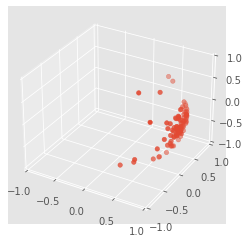

In [6]:
f_3d =Flock_3d(100,0.5,15)
n = f_3d.get_noise(0.4)
# d=np.array([[0,0,1]])
# r =get_rotation_matrices(d)
r= np.array([[[0,0,1],[0,1,0],[1,0,0]]])
nr = np.matmul(r[0],n.T).T

fig = plt.figure()
ax = plt.subplot(111,projection="3d")
ax.set(xlim=(-1,1),ylim=(-1,1),zlim=(-1,1))
ax.scatter(nr[:,0],nr[:,1],nr[:,2])
ax.azim = -60


In [3]:
from flock import *
f_3d = Flock_3d(10,0.5,15)
##need np.dot,np.tensordot, lag.cross,R.from_quat,R.as_matrix

# def get_rotation_quats(directions,verbose =False):
#     """Returns an array of rotation matrices that rotates i^ to the given directions """
#     ##calculate the cross product between i_hat and a given direction, and rotate about that axis by the angle between them
#     ##returns rotation matrices
#     ds =directions
#     N = ds.shape[0]
#     i_hats = np.tile([1,0,0],(N,1))

#     ##calculating rotation angle using |a||b|cos(theta)
#     dots = ds[:,0]
#     norms = lag.norm(ds,axis=1)
#     angles =-np.arccos(dots/norms)
#     angles_deg = 360*angles/(2*np.pi) ##TODO this isn't right

#     ##normalising using 1/|a||b|sin(theta)
#     axis_norms = np.tile(norms*np.sin(angles),(3,1)).transpose()
#     axis = np.divide(np.cross(i_hats,ds),axis_norms)

#     ##generating quaternions of the form (cos(theta/2),sin(theta/2)*axis) which rotate about axis by angle theta
#     cos_a = np.cos(angles/2).reshape(N,1)
#     sin_a = np.tile(np.sin(angles/2),(3,1)).transpose()
#     quats = np.concatenate((cos_a,sin_a*axis),axis=1)
#     # sin_a = np.sin(angles/2).reshape(N,1)
#     # cos_a = np.tile(np.cos(angles/2),(3,1)).transpose()
#     # quats = np.concatenate((sin_a,cos_a*axis),axis=1)
#     if verbose:
#         print(f"Cos_a = {cos_a} and Sin_a = {sin_a}")
#         print(f"The angles of rotation are {angles_deg}. \n The axes of rotation are {axis}. \n This gives quaternions {quats}")
#     ##generating rotation matrices for each rotation
#     r =R.from_quat(quats)
#     return r.as_quats()

def get_spherical(directions):
        x =directions[:,0]
        y =directions[:,1]
        z =directions[:,2]
        x2_y2 =x**2+y**2
        rs = np.sqrt(x2_y2 +z**2)
        phis = -np.arctan2(z,np.sqrt(x2_y2))
        thetas = np.arctan2(y,x)
        return rs,thetas,phis

def get_rotation_matrices(directions):
    """Gets spherical coordinates for directions and the multiplies rotation matrices """
    rs,thetas,phis = get_spherical(directions)
    zero = np.zeros(phis.shape)
    one =np.ones(phis.shape)
    rot_thetas = np.array([[np.cos(thetas),-np.sin(thetas),zero],[np.sin(thetas),np.cos(thetas),zero],[zero,zero,one]])
    rot_thetas =np.moveaxis(rot_thetas,2,0)
    rot_phis = np.array([[np.cos(phis),zero,np.sin(phis)],[zero,one,zero],[-np.sin(phis),zero,np.cos(phis)]])
    rot_phis =np.moveaxis(rot_phis,2,0)
    # print(f"rot_thetas ={rot_thetas},\n rot_phis = {rot_phis}")
    return np.matmul(rot_thetas,rot_phis)
N=10
f_3d = Flock_3d(N,0.5,15)
# d =f_3d.directions
# d_tiled = np.tile(f_3d.directions,(1,3)).reshape(N,3,3)
d= np.array([[1,0,0],[-1,-1,0],[0,1,1]])
r =get_rotation_matrices(d)

print(np.moveaxis(np.tensordot(d, r, axes=((1), (1))),1,0))
np.matmul(r[1],d[0])
# print(np.moveaxis(np.tensordot(d, r, axes=((-1), (-1))),1,0))

SyntaxError: invalid syntax (flock.py, line 271)

In [11]:
f_3d = Flock_3d(200,0.5,6)
%timeit f_3d.update_posdirs(1,0.2)

4.83 ms ± 478 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


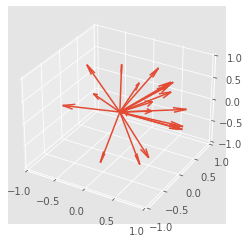

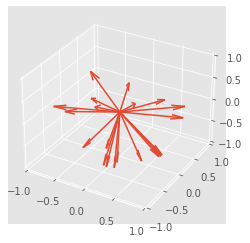

In [60]:
fig = plt.figure()
ax = fig.add_subplot(111,projection="3d")
# p =f_3d.positions
f_3d =Flock_3d(20,0.5,15)
d =f_3d.directions
p =np.zeros(d.shape)
ax.set(xlim=(-1,1),ylim=(-1,1),zlim=(-1,1))
ax.quiver(p[:,0],p[:,1],p[:,2],d[:,0],d[:,1],d[:,2],length=1,arrow_length_ratio=0.2)
r = get_rotation_matrices(d)
dr =np.matmul(r[0],d.transpose()).transpose()

fig = plt.figure()
ax = fig.add_subplot(111,projection="3d")
ax.set(xlim=(-1,1),ylim=(-1,1),zlim=(-1,1))
ax.quiver(p[:,0],p[:,1],p[:,2],dr[:,0],dr[:,1],dr[:,2],length=1,arrow_length_ratio=0.2)

In [10]:
f_3d =Flock_3d(100,0.5,15)
n = f_3d.get_noise(0.1)

fig = plt.figure()
ax = plt.subplot(111,projection="3d")
ax.set(xlim=(-1,1),ylim=(-1,1),zlim=(-1,1))
ax.scatter(n[:,0],n[:,1],n[:,2])

r = get_rotation_matrices(np.array([[1,1,1]]),verbose= True)
k = np.array([0,0,1])
kr = np.matmul(r[0],k.transpose()).transpose()
print(kr)
print(r[0])
fig = plt.figure()
ax = plt.subplot(111,projection="3d")
ax.set(xlim=(-1,1),ylim=(-1,1),zlim=(-1,1))
ax.scatter(nr[:,0],nr[:,1],nr[:,2])


Cos_a = [[0.88807383]] and Sin_a = [[-0.45970084 -0.45970084 -0.45970084]]
The angles of rotation are [-54.73561032]. 
 The axes of rotation are [[-0.          0.70710678 -0.70710678]]. 
 This gives quaternions [[ 0.88807383  0.         -0.32505758  0.32505758]]
[-0.57735027 -0.57735027 -0.57735027]
[[ 0.78867513  0.21132487 -0.57735027]
 [-0.21132487 -0.78867513 -0.57735027]
 [-0.57735027  0.57735027 -0.57735027]]


NameError: name 'nr' is not defined

In [ ]:
r = R.from_quat((np.cos()))

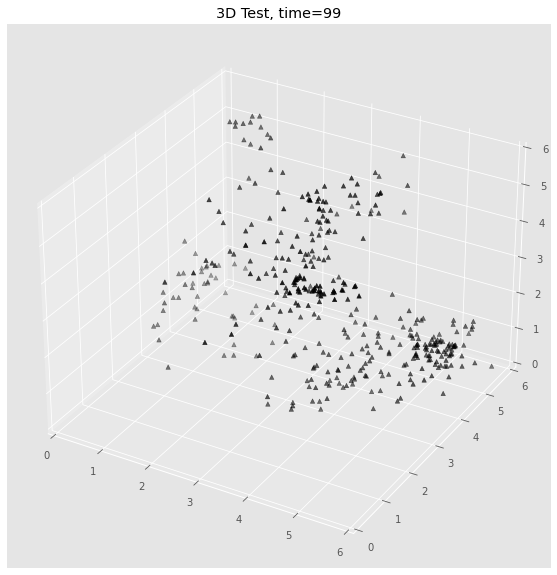

In [50]:
fname = r"C://Users//bennm//Documents//UNI//Year 2//Mathematical Programming//Project//vicsek-model-group3//vicsek_flocking_3d_2.mp4"
writervideo = animation.FFMpegWriter(fps=60) 
ani.save(fname, writer=writervideo)

In [1]:
p = f_3d.positions
cdist
vec = np.array([1,1,1])
tiled_vec = np.tile(vec,(p.shape[0],1))
dir_vec = p-tiled_vec

NameError: name 'f_3d' is not defined

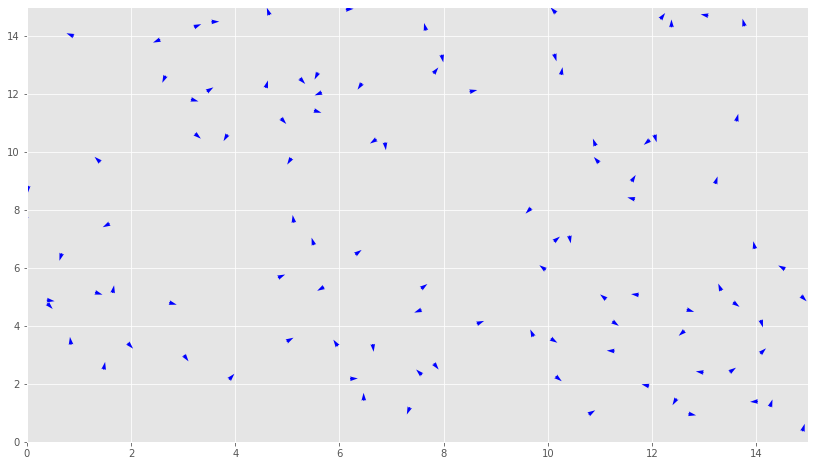

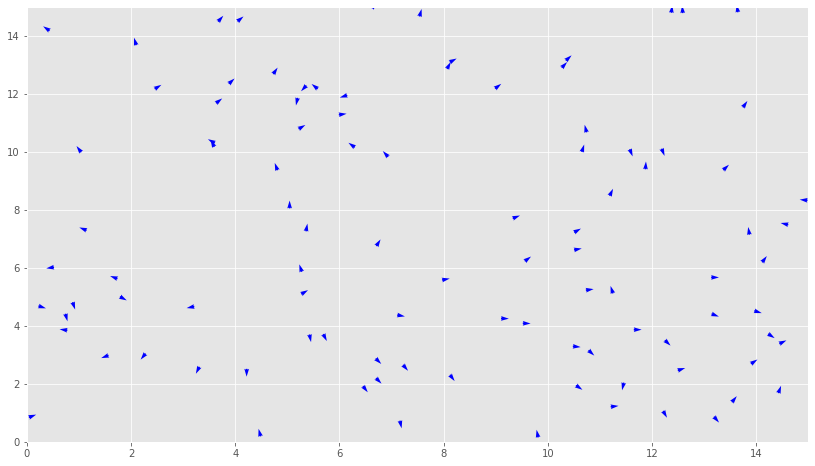

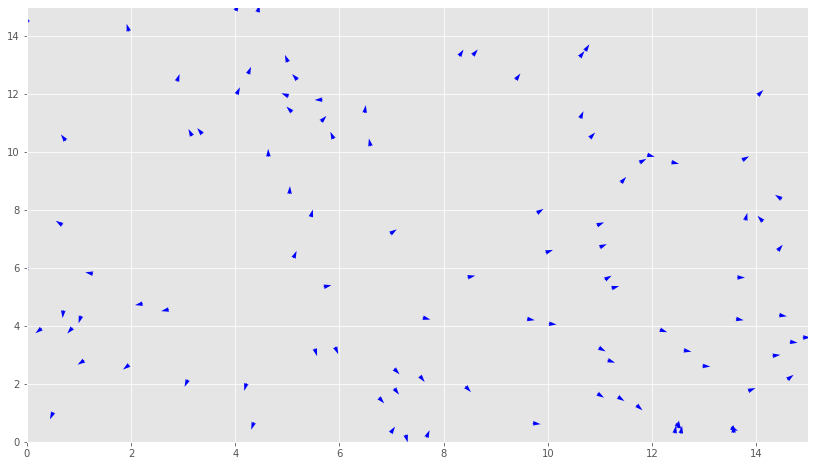

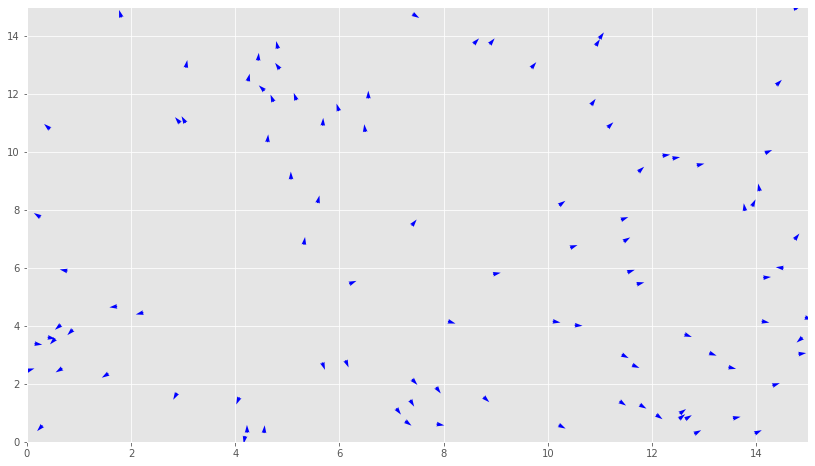

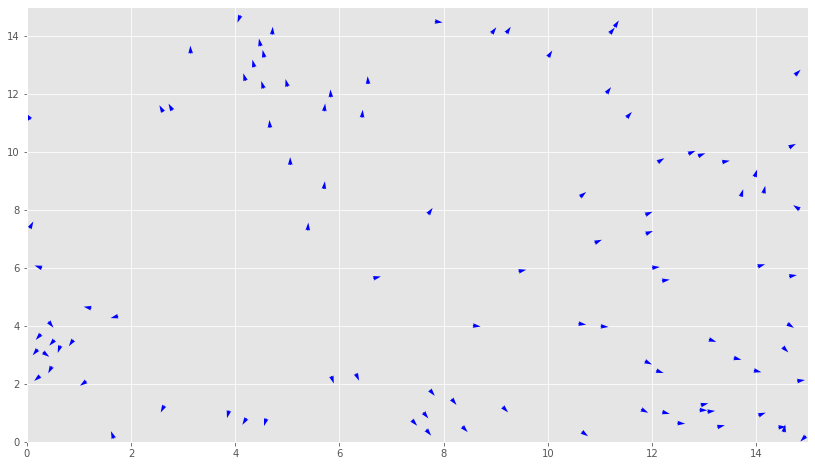

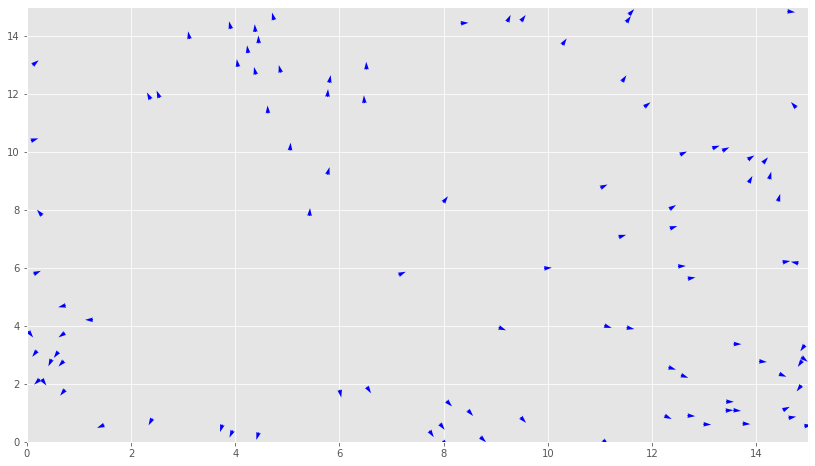

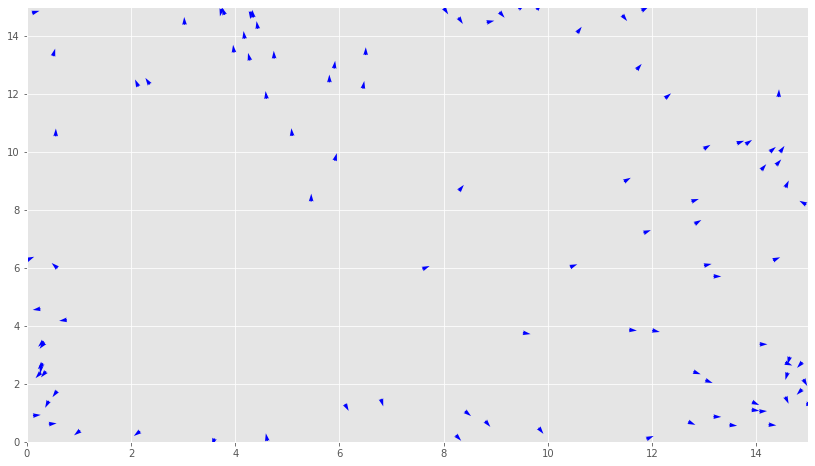

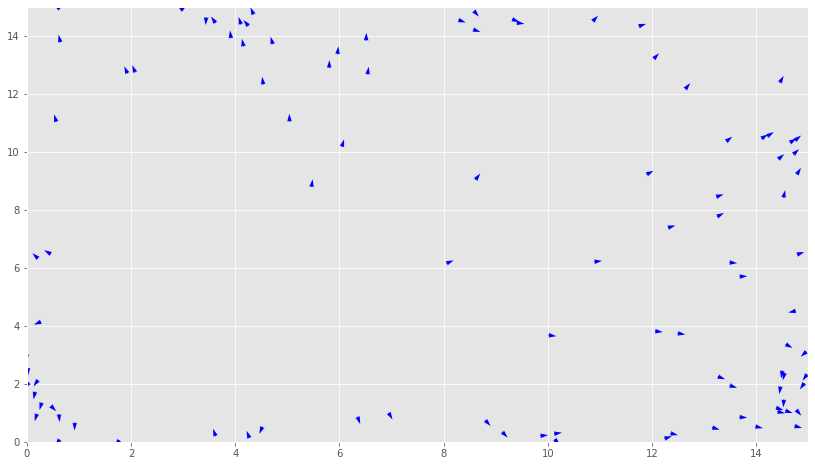

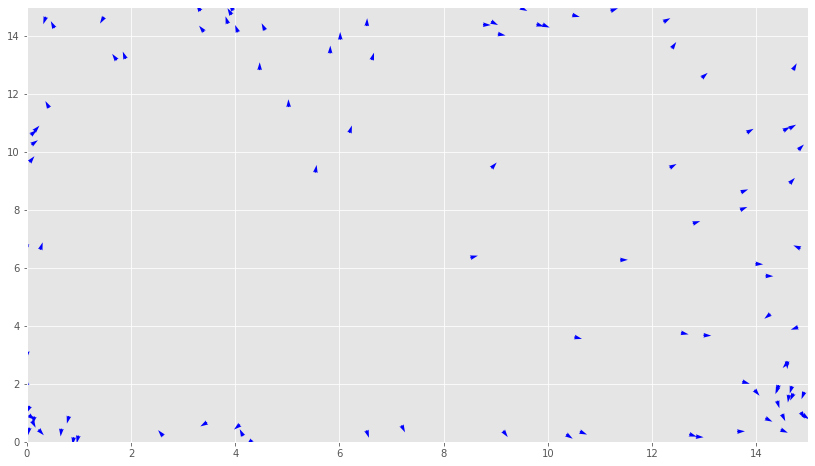

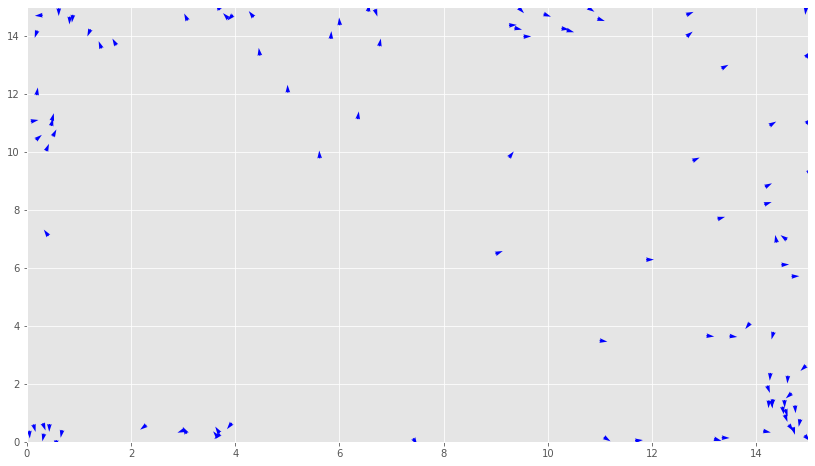

In [2]:
from flock import *
pr = Prey(100,0.5,15)
for i in range(10):
    pr.display_state()
    pr.update_posdirs(1,0.1,(5,5),10)